# Program for merging all mean values and coordinates into a single file & then analyze data using logistic regression models
1. Merge all CSV files containing various mean values
2. Fitting logistic regression models for analysis
   a. Fitting ML models with NA's filled with zeros
   b. ML models with filtering all NA data records

1. Merge all CSV files containing various mean values

In [ ]:
import os
import glob
import pandas as pd


In [ ]:
# Define the directory containing the files
directory =  '../data/11_Output_R/'  #'/content/'
outdir ='../data/12_Output_python/'

filelist = glob.glob(directory+"Citywise Means*.csv")
print(filelist)

# Initialize an empty DataFrame for final merged means data
ML_data = pd.DataFrame()

first = True
# Loop through all Citywise Means csv files in the directory
for fl in filelist:  #os.listdir(directory):
    flname =  fl
    print(flname)

    # Read the CSV file into a DataFrame
    df1 = pd.read_csv(flname, encoding="utf-8")

    # merge df1 to ML_data
    if (first):
        ML_data = df1
        first = False
    else:
        ML_data = pd.concat([ML_data, df1], ignore_index=True)

#save to csv
ML_data.to_csv( outdir+'UHI_NDVI_Swater_Means_data.csv', index=False, encoding="utf-8")

# Without 'NA values'
ML_data_cleaned = ML_data.dropna()

ML_data_cleaned.to_csv( outdir+'cleaned_UHI_NDVI_Swater_Means_data.csv', index=False, encoding="utf-8")

print("All records have been appended and saved to 'UHI_NDVI_Swater_Means_data.csv'")
print("Records with 'NA' values have been removed and saved to 'cleaned_UHI_NDVI_Swater_Means_data.csv'")


['../data/11_Output_R\\Citywise Means 0 .csv', '../data/11_Output_R\\Citywise Means 1 .csv', '../data/11_Output_R\\Citywise Means 10 .csv', '../data/11_Output_R\\Citywise Means 2 .csv', '../data/11_Output_R\\Citywise Means 3 .csv', '../data/11_Output_R\\Citywise Means 4 .csv', '../data/11_Output_R\\Citywise Means 5 .csv', '../data/11_Output_R\\Citywise Means 6 .csv', '../data/11_Output_R\\Citywise Means 7 .csv', '../data/11_Output_R\\Citywise Means 8 .csv', '../data/11_Output_R\\Citywise Means 9 .csv']
../data/11_Output_R\Citywise Means 0 .csv
../data/11_Output_R\Citywise Means 1 .csv
../data/11_Output_R\Citywise Means 10 .csv
../data/11_Output_R\Citywise Means 2 .csv
../data/11_Output_R\Citywise Means 3 .csv
../data/11_Output_R\Citywise Means 4 .csv
../data/11_Output_R\Citywise Means 5 .csv
../data/11_Output_R\Citywise Means 6 .csv
../data/11_Output_R\Citywise Means 7 .csv
../data/11_Output_R\Citywise Means 8 .csv
../data/11_Output_R\Citywise Means 9 .csv
All records have been appende

In [ ]:

dir1 =  outdir # ''  #'/content/'
dir2 = '../data/10_raw_Other_variables/'
dir3 = ''

file_path1 = os.path.join(dir1, 'UHI_NDVI_Swater_Means_data.csv')
file_path2 = os.path.join(dir2, 'combined_summary_City_Shape.csv')
file_path3 = os.path.join(dir3, 'City_coordinates.csv')
# Read the CSV file into a DataFrame
df_means = pd.read_csv(file_path1, encoding="utf-8")
df_city_shape = pd.read_csv(file_path2, encoding="utf-8")
df_coord = pd.read_csv(file_path3, encoding="utf-8")

print(df_means.shape)
print(df_city_shape.shape)
print(df_coord.shape)

#merge with coordinates data
df_means_coord = pd.merge( df_coord, df_means, on='city', how='left' )


df_means_coord.rename(columns={'city': 'City'}, inplace=True)
df_means.rename(columns={'city': 'City'}, inplace=True)

all_data_coord = pd.merge(df_means_coord, df_city_shape  , on='City', how='left'  )
all_data = pd.merge(df_means, df_city_shape  , on='City' , how='left' )

# Saveto CSV
all_data_coord.to_csv(dir1+'ML_input_data_coordinates.csv', index=False, encoding="utf-8")
all_data.to_csv(dir1+'ML_input_data.csv', index=False, encoding="utf-8")

print( all_data)

(6000, 7)
(5995, 6)
(6018, 4)
      Unnamed: 0        City    mean_ndvi  mean_surface_water  \
0              1     Aalborg  4679.282689            2.672234   
1              2      Aarhus  4766.372778            2.916598   
2              3         Aba  4547.316116            1.392857   
3              4      Abadan  1198.098344            1.915596   
4              5  Abaetetuba  4336.336242            2.055556   
...          ...         ...          ...                 ...   
5995         595  Ziguinchor  3857.942809            2.096154   
5996         596      Zilina  4653.904400            2.469136   
5997         597        Zima  2841.209456            2.272109   
5998         598      Zinder  1955.720430            1.840000   
5999         599      Zixing  5895.471659            2.000000   

      mean_uhi_DayNight  mean_uhi_daytime  mean_uhi_Nighttime      Continent  \
0              1.161372          0.759178            0.402194         EUROPE   
1              1.047580      

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.formula.api as sm
from sklearn.preprocessing import MinMaxScaler

In [ ]:
dir1 = ''
UHI_data = pd.read_csv(dir1+'ML_input_data_coordinates.csv',  encoding="utf-8")

In [ ]:
# EDA
UHI_data.head()
UHI_data.describe()
UHI_data.describe(include = 'all')

,City,longitude,latitude,coordinates,Unnamed: 0,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Continent,Class,Skewness,Dip_Statistic,Mean_Height
count,6018,6018.000000,6018.000000,6018,6000.000000,5997.000000,5487.000000,3837.000000,3837.000000,3837.000000,5983,5983,5983.000000,5983.000000,5983.000000
unique,6018,NaN,NaN,6016,NaN,NaN,NaN,NaN,NaN,NaN,7,5,NaN,NaN,NaN
top,Brochet,NaN,NaN,"[-155.80635752182368, 22.05491408827139]",NaN,NaN,NaN,NaN,NaN,NaN,ASIA,Pyramid,NaN,NaN,NaN
freq,1,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,1676,3354,NaN,NaN,NaN
mean,NaN,10.436025,20.682179,NaN,298.827167,3983.282197,2.063456,1.366485,0.794803,0.571680,NaN,NaN,1.858064,0.403452,1.210399
std,NaN,78.767277,28.029787,NaN,173.175589,1645.491202,0.531691,1.168282,1.080710,0.493389,NaN,NaN,1.873677,0.446437,0.724661
min,NaN,-175.206801,-54.806550,NaN,1.000000,0.000000,1.000000,-6.495676,-6.771884,-2.501164,NaN,NaN,-1.188415,0.000000,0.000000
25%,NaN,-65.819197,-0.080569,NaN,149.000000,2996.740095,1.666667,0.768366,0.282230,0.252565,NaN,NaN,0.781813,0.000000,0.701171
50%,NaN,18.685930,27.909327,NaN,299.000000,4192.147504,2.000000,1.385278,0.845177,0.498285,NaN,NaN,1.444997,0.086023,1.167897
75%,NaN,73.078158,43.120232,NaN,449.000000,5226.841989,2.506806,2.017854,1.395688,0.834690,NaN,NaN,2.319558,0.976694,1.638124


In [ ]:
UHI_data = UHI_data.drop(columns=['coordinates','Unnamed: 0', 'Continent', 'City'])
UHI_data.head()

,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,-101.662499,57.887499,1866.260870,3.000000,NaN,NaN,NaN,Pyramid,2.742307,0.994268,0.105348
1,-141.195832,64.787499,2407.538889,2.500000,NaN,NaN,NaN,Pyramid,3.487868,0.999807,0.005516
2,-164.520832,62.787498,2970.785534,NaN,NaN,NaN,NaN,Unknown,0.000000,1.000000,0.000000
3,-171.012498,65.587501,793.725581,2.333333,NaN,NaN,NaN,Pyramid,0.648028,0.196626,0.093306
4,-110.737501,62.404167,1330.292918,2.750000,NaN,NaN,NaN,Pyramid,0.606570,0.290467,0.172865


In [ ]:

UHI_data.describe()
UHI_data.describe(include = 'all')
UHI_data[['Class']].value_counts()
UHI_data.isna().sum()

UHI_data['Class'].replace(['Pyramid','Hourglass', 'Diamond', 'Inverse Pyramid','Unknown','NA' ],[1,2,3,4,5,6], inplace= True)

UHI_data.head()

#sns.pairplot(UHI_data,hue='Class')
#sns.pairplot(UHI_data,hue='mean_uhi_DayNight')

<ipython-input-38-7a30cdf7c1e7>:11: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  UHI_data['Class'].replace(['Pyramid','Hourglass', 'Diamond', 'Inverse Pyramid','Unknown','NA' ],[1,2,3,4,5,6], inplace= True)
<ipython-input-38-7a30cdf7c1e7>:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  UHI_data['

,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,-101.662499,57.887499,1866.260870,3.000000,NaN,NaN,NaN,1.0,2.742307,0.994268,0.105348
1,-141.195832,64.787499,2407.538889,2.500000,NaN,NaN,NaN,1.0,3.487868,0.999807,0.005516
2,-164.520832,62.787498,2970.785534,NaN,NaN,NaN,NaN,5.0,0.000000,1.000000,0.000000
3,-171.012498,65.587501,793.725581,2.333333,NaN,NaN,NaN,1.0,0.648028,0.196626,0.093306
4,-110.737501,62.404167,1330.292918,2.750000,NaN,NaN,NaN,1.0,0.606570,0.290467,0.172865


# 2. Fitting logistic regression models for analysis

a. Fitting ML models with NA's filled with zeros

Optimization terminated successfully.
         Current function value: 0.657413
         Iterations 4


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:      mean_uhi_DayNight   No. Observations:                 3819
Model:                          Logit   Df Residuals:                     3815
Method:                           MLE   Df Model:                            3
Date:                Mon, 09 Dec 2024   Pseudo R-squ.:                 -0.9574
Time:                        16:16:39   Log-Likelihood:                -2510.7
converged:                       True   LL-Null:                       -1282.7
Covariance Type:            nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept              0.1463      0.120      1.221      0.222      -0.088       0.381
mean_ndvi              0.4646      0.162      2.863      0.004       0.147       0.783
Class                  0.1216      0.133      0.917      0.359      -0.138       0.382
mean_surface_water    -0.0748      0.129     -0.578      0.564      -0.328       0.179
======================================================================================
"""

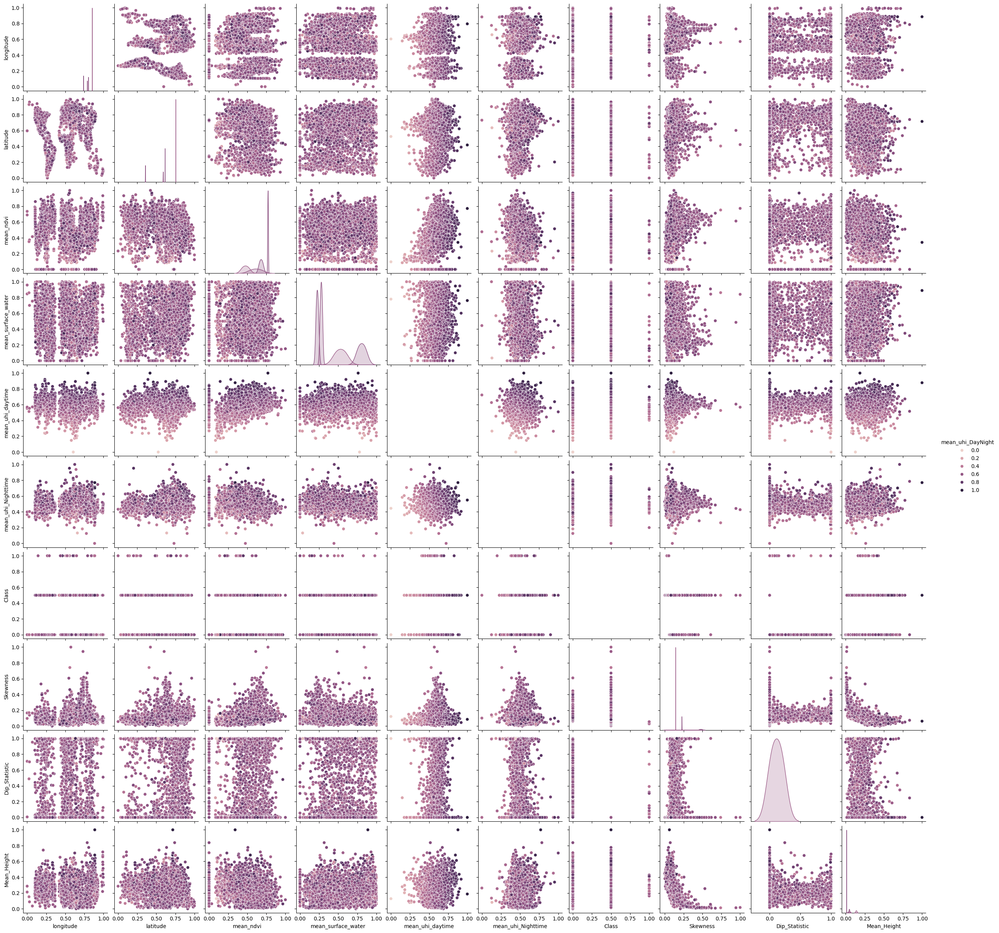

In [ ]:
# fit Logistic regression model between UHI Day and Night mean value  and  ndvi mean, City shape, surface_water mean values with NA's filled with zeros
scaler = MinMaxScaler()
arr_scaled = scaler.fit_transform(UHI_data)

UHI_scaled = pd.DataFrame(scaler.fit_transform(UHI_data), columns=UHI_data.columns,index=UHI_data.index)
UHI_scaled.head()
sns.pairplot(UHI_scaled,hue='mean_uhi_DayNight')

UHI_scaled['mean_uhi_DayNight']= UHI_scaled['mean_uhi_DayNight'].fillna(0)
UHI_scaled['mean_surface_water']= UHI_scaled['mean_surface_water'].fillna(0)
UHI_scaled['mean_ndvi']= UHI_scaled['mean_ndvi'].fillna(0)

UHI_scaled['mean_uhi_DayNight']= UHI_scaled['mean_uhi_DayNight']

logit_res= sm.logit('mean_uhi_DayNight ~ mean_ndvi + Class +mean_surface_water', data= UHI_scaled ).fit()

logit_res.summary()
logit_res.pred_table()
logit_res.summary()

In [ ]:

# fit Logistic regression model between UHI Day and Night mean value  and  ndvi mean, surface_water mean values

logit_res= sm.logit('mean_uhi_DayNight ~ mean_ndvi + Class +mean_surface_water', data= UHI_scaled ).fit()
#logit_res=logit_mod.fit()
logit_res.pred_table()

TN = logit_res.pred_table()[0,0]
TP = logit_res.pred_table()[1,1]
FN = logit_res.pred_table()[1,0]
FP = logit_res.pred_table()[0,1]

logit_res.summary()





Optimization terminated successfully.
         Current function value: 0.657413
         Iterations 4


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:      mean_uhi_DayNight   No. Observations:                 3819
Model:                          Logit   Df Residuals:                     3815
Method:                           MLE   Df Model:                            3
Date:                Mon, 09 Dec 2024   Pseudo R-squ.:                 -0.9574
Time:                        18:25:33   Log-Likelihood:                -2510.7
converged:                       True   LL-Null:                       -1282.7
Covariance Type:            nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept              0.1463      0.120      1.221      0.222      -0.088       0.381
mean_ndvi              0.4646      0.162      2.863      0.004       0.147       0.783
Class                  0.1216      0.133      0.917      0.359      -0.138       0.382
mean_surface_water    -0.0748      0.129     -0.578      0.564      -0.328       0.179
======================================================================================
"""

In [ ]:
Accuracy = (TP+TN)/(TP+TN+FP+FN)
Recall = TP/(TP+FN)
Precision = TP/(TP+FP)

[Accuracy,Recall,Precision]

[0.8876669285153181, 1.0, 0.8876669285153181]

In [ ]:
# fit Logistic regression model between City Shape and UHI Day and Night mean value

logit_res= sm.logit('Class ~ mean_uhi_DayNight ', data= UHI_scaled ).fit()

logit_res.pred_table()

TN = logit_res.pred_table()[0,0]
TP = logit_res.pred_table()[1,1]
FN = logit_res.pred_table()[1,0]
FP = logit_res.pred_table()[0,1]

logit_res.summary()

Optimization terminated successfully.
         Current function value: 0.501699
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                  Class   No. Observations:                 3819
Model:                          Logit   Df Residuals:                     3817
Method:                           MLE   Df Model:                            1
Date:                Mon, 09 Dec 2024   Pseudo R-squ.:                 -0.3264
Time:                        18:26:39   Log-Likelihood:                -1916.0
converged:                       True   LL-Null:                       -1444.5
Covariance Type:            nonrobust   LLR p-value:                     1.000
=====================================================================================
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            -1.6500      0.256     -6.450      0.000      -2.151      -1.149
mean_uhi_DayNight     0.9911      0.424      2.335      0.020       0.159       1.823
=====================================================================================
"""

In [ ]:
Accuracy = (TP+TN)/(TP+TN+FP+FN)
Recall = TP/(TP+FN)
Precision = TP/(TP+FP)

[Accuracy,Recall,Precision]

<ipython-input-26-cb6732c6a912>:3: RuntimeWarning: invalid value encountered in scalar divide
  Precision = TP/(TP+FP)


[0.49096622152395913, 0.0, nan]

In [ ]:
# fit Logistic regression model between City Shape and UHI Daytime mean value

logit_res= sm.logit('Class ~ mean_uhi_daytime ', data= UHI_scaled ).fit()

logit_res.pred_table()

TN = logit_res.pred_table()[0,0]
TP = logit_res.pred_table()[1,1]
FN = logit_res.pred_table()[1,0]
FP = logit_res.pred_table()[0,1]
logit_res.summary()

Optimization terminated successfully.
         Current function value: 0.502247
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                  Class   No. Observations:                 3819
Model:                          Logit   Df Residuals:                     3817
Method:                           MLE   Df Model:                            1
Date:                Mon, 09 Dec 2024   Pseudo R-squ.:                 -0.3278
Time:                        18:28:14   Log-Likelihood:                -1918.1
converged:                       True   LL-Null:                       -1444.5
Covariance Type:            nonrobust   LLR p-value:                     1.000
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept           -1.0333      0.261     -3.956      0.000      -1.545      -0.521
mean_uhi_daytime    -0.0461      0.431     -0.107      0.915      -0.891       0.799
====================================================================================
"""

In [ ]:
Accuracy = (TP+TN)/(TP+TN+FP+FN)
Recall = TP/(TP+FN)
Precision = TP/(TP+FP)

[Accuracy,Recall,Precision]

<ipython-input-28-cb6732c6a912>:3: RuntimeWarning: invalid value encountered in scalar divide
  Precision = TP/(TP+FP)


[0.49096622152395913, 0.0, nan]

In [ ]:
# fit Logistic regression model between City Shape and UHI Nighttime mean value

logit_res= sm.logit('Class ~ mean_uhi_Nighttime', data= UHI_scaled ).fit()

logit_res.pred_table()

TN = logit_res.pred_table()[0,0]
TP = logit_res.pred_table()[1,1]
FN = logit_res.pred_table()[1,0]
FP = logit_res.pred_table()[0,1]

logit_res.summary()

Optimization terminated successfully.
         Current function value: 0.498552
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                  Class   No. Observations:                 3819
Model:                          Logit   Df Residuals:                     3817
Method:                           MLE   Df Model:                            1
Date:                Mon, 09 Dec 2024   Pseudo R-squ.:                 -0.3181
Time:                        18:28:57   Log-Likelihood:                -1904.0
converged:                       True   LL-Null:                       -1444.5
Covariance Type:            nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -2.3764      0.234    -10.160      0.000      -2.835      -1.918
mean_uhi_Nighttime     2.6574      0.463      5.739      0.000       1.750       3.565
======================================================================================
"""

In [ ]:
Accuracy = (TP+TN)/(TP+TN+FP+FN)
Recall = TP/(TP+FN)
Precision = TP/(TP+FP)

[Accuracy,Recall,Precision]

[0.49148991882691806, 0.0015432098765432098, 0.75]

In [ ]:
# normalize data for pair plot
scaler = MinMaxScaler()
arr_scaled = scaler.fit_transform(UHI_data)

UHI_scaled = pd.DataFrame(scaler.fit_transform(UHI_data), columns=UHI_data.columns,index=UHI_data.index)
UHI_scaled.head()

,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,0.207940,0.851877,0.222614,1.000000,0.5,NaN,NaN,0.0,0.118445,0.994268,0.017824
1,0.096163,0.904036,0.287180,0.833333,0.5,NaN,NaN,0.0,0.140911,0.999807,0.000933
2,0.030214,0.888917,0.354366,0.000000,0.5,NaN,NaN,1.0,0.035811,1.000000,0.000000
3,0.011859,0.910083,0.094678,0.777778,0.5,NaN,NaN,0.0,0.055338,0.196626,0.015786
4,0.182282,0.886020,0.158682,0.916667,0.5,NaN,NaN,0.0,0.054089,0.290467,0.029247


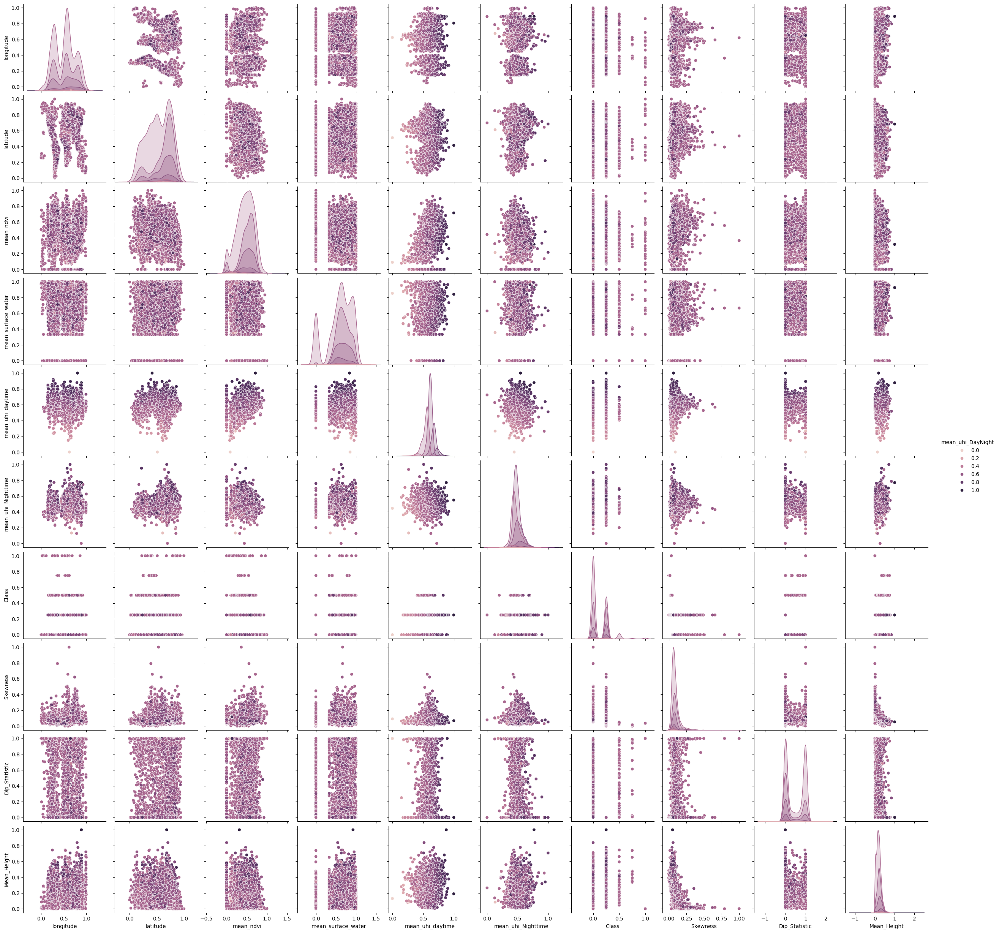

In [ ]:
# Pairplot using m=normalized data
sns.pairplot(UHI_scaled,hue='mean_uhi_DayNight')

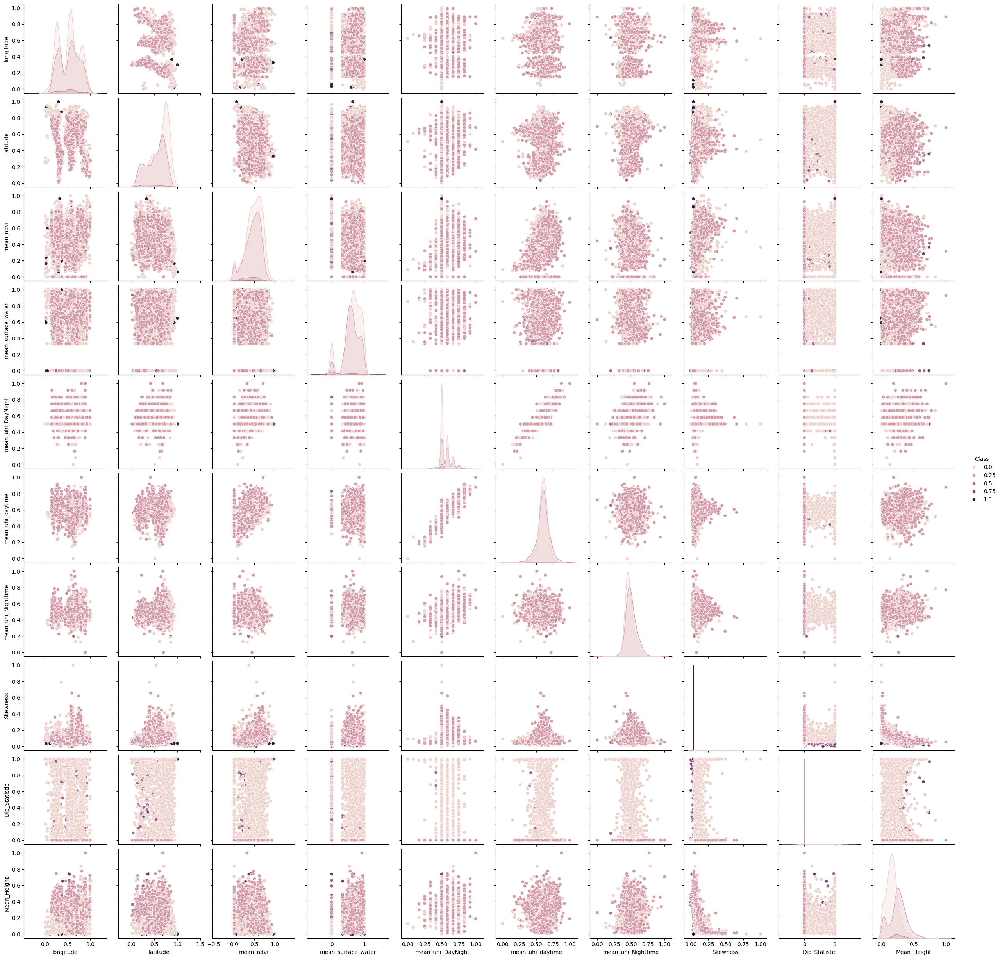

In [ ]:
sns.pairplot(UHI_scaled,hue='Class')

In [ ]:
# fit Logistic regression model between UHI Day and Night mean value  and  ndvi mean, City shape, surface_water mean values, mean height, skewness, Dip statistic with NA replaced by 0
# EDA

UHI_scaled['mean_uhi_DayNight']= UHI_scaled['mean_uhi_DayNight'].fillna(0)
UHI_scaled['mean_surface_water']= UHI_scaled['mean_surface_water'].fillna(0)
UHI_scaled['mean_ndvi']= UHI_scaled['mean_ndvi'].fillna(0)

UHI_scaled['mean_uhi_DayNight']= UHI_scaled['mean_uhi_DayNight']

logit_res= sm.logit('mean_uhi_DayNight ~ mean_ndvi + Class +mean_surface_water +Mean_Height+ Skewness	+Dip_Statistic', data= UHI_scaled ).fit()

logit_res.summary()
logit_res.pred_table()



Optimization terminated successfully.
         Current function value: 0.679784
         Iterations 4


array([[2.000e+00, 1.110e+02],
       [1.990e+02, 5.671e+03]])

In [ ]:
logit_res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:      mean_uhi_DayNight   No. Observations:                 5983
Model:                          Logit   Df Residuals:                     5976
Method:                           MLE   Df Model:                            6
Date:                Mon, 02 Dec 2024   Pseudo R-squ.:                 -0.4167
Time:                        03:51:13   Log-Likelihood:                -4067.1
converged:                       True   LL-Null:                       -2870.8
Covariance Type:            nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -0.1964      0.145     -1.354      0.176      -0.481       0.088
mean_ndvi              0.2409      0.136      1.777      0.076      -0.025       0.507
Class                 -0.0385      0.226     -0.171      0.865      -0.481       0.404
mean_surface_water     0.0686      0.105      0.655      0.513      -0.137       0.274
Mean_Height            0.8597      0.284      3.027      0.002       0.303       1.416
Skewness               1.1578      0.582      1.988      0.047       0.016       2.300
Dip_Statistic         -0.0814      0.076     -1.073      0.283      -0.230       0.067
======================================================================================
"""

In [ ]:
# Model with deleting all NA values
dir1 = ''
UHI_data1 = pd.read_csv(dir1+'ML_input_data_coordinates.csv',  encoding="utf-8")

In [ ]:
# EDA
UHI_data1.head()
UHI_data1.describe()
UHI_data1.describe(include = 'all')

,City,longitude,latitude,coordinates,Unnamed: 0,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Continent,Class,Skewness,Dip_Statistic,Mean_Height
count,6018,6018.000000,6018.000000,6018,6000.000000,5997.000000,5487.000000,3837.000000,3837.000000,3837.000000,5983,5983,5983.000000,5983.000000,5983.000000
unique,6018,NaN,NaN,6016,NaN,NaN,NaN,NaN,NaN,NaN,7,5,NaN,NaN,NaN
top,Brochet,NaN,NaN,"[-155.80635752182368, 22.05491408827139]",NaN,NaN,NaN,NaN,NaN,NaN,ASIA,Pyramid,NaN,NaN,NaN
freq,1,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,1676,3354,NaN,NaN,NaN
mean,NaN,10.436025,20.682179,NaN,298.827167,3983.282197,2.063456,1.366485,0.794803,0.571680,NaN,NaN,1.858064,0.403452,1.210399
std,NaN,78.767277,28.029787,NaN,173.175589,1645.491202,0.531691,1.168282,1.080710,0.493389,NaN,NaN,1.873677,0.446437,0.724661
min,NaN,-175.206801,-54.806550,NaN,1.000000,0.000000,1.000000,-6.495676,-6.771884,-2.501164,NaN,NaN,-1.188415,0.000000,0.000000
25%,NaN,-65.819197,-0.080569,NaN,149.000000,2996.740095,1.666667,0.768366,0.282230,0.252565,NaN,NaN,0.781813,0.000000,0.701171
50%,NaN,18.685930,27.909327,NaN,299.000000,4192.147504,2.000000,1.385278,0.845177,0.498285,NaN,NaN,1.444997,0.086023,1.167897
75%,NaN,73.078158,43.120232,NaN,449.000000,5226.841989,2.506806,2.017854,1.395688,0.834690,NaN,NaN,2.319558,0.976694,1.638124


 b. ML models with filtering all NA data records

In [ ]:
# Filtering records with 'NA' values


UHI_data = UHI_data[UHI_data['Class'].notna()]
UHI_data = UHI_data[UHI_data['Class'] != 'Unknown']
UHI_data = UHI_data[UHI_data['mean_uhi_DayNight'].notna()]

UHI_data = UHI_data[UHI_data['mean_uhi_daytime'].notna()]
UHI_data = UHI_data[UHI_data['mean_uhi_Nighttime'].notna()]

UHI_data['Class'].replace(['Pyramid','Hourglass', 'Diamond', 'Inverse Pyramid','Unknown','NA' ],[1,2,3,4,5,6], inplace= True)

UHI_data.head()



<ipython-input-11-dcc7da5731ca>:19: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  UHI_data['Class'].replace(['Pyramid','Hourglass', 'Diamond', 'Inverse Pyramid','Unknown','NA' ],[1,2,3,4,5,6], inplace= True)


,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
14,-68.912502,-49.979167,1804.630435,NaN,0.518773,0.315141,0.203633,3,0.464226,0.088518,1.699707
61,124.712499,56.662499,1918.596838,NaN,1.522096,-0.333315,1.855411,3,-0.030597,0.993133,2.404187
75,-76.708332,-11.937502,1073.708075,NaN,-1.581626,-2.940790,1.359164,1,0.916480,0.849273,2.280363
91,-109.929168,27.587499,3308.429842,2.000000,1.083598,0.022550,1.061048,3,0.406120,0.017223,1.467968
103,48.662500,55.833334,2896.117140,2.227273,0.069345,-0.458743,0.528088,1,0.856603,0.996525,1.071370


In [ ]:
UHI_data1 = UHI_data1.drop(columns=['coordinates','Unnamed: 0', 'Continent', 'City'])
UHI_data1.head()

,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,-101.662499,57.887499,1866.260870,3.000000,NaN,NaN,NaN,Pyramid,2.742307,0.994268,0.105348
1,-141.195832,64.787499,2407.538889,2.500000,NaN,NaN,NaN,Pyramid,3.487868,0.999807,0.005516
2,-164.520832,62.787498,2970.785534,NaN,NaN,NaN,NaN,Unknown,0.000000,1.000000,0.000000
3,-171.012498,65.587501,793.725581,2.333333,NaN,NaN,NaN,Pyramid,0.648028,0.196626,0.093306
4,-110.737501,62.404167,1330.292918,2.750000,NaN,NaN,NaN,Pyramid,0.606570,0.290467,0.172865


In [ ]:
UHI_data1.head()
UHI_data1.describe()
UHI_data1.describe(include = 'all')
UHI_data1[['Class']].value_counts()
UHI_data1.isna().sum()


UHI_data1['Class'].replace(['Pyramid','Hourglass', 'Diamond', 'Inverse Pyramid','Unknown','NA' ],[1,2,3,4,5,6], inplace= True)

UHI_data1.head()


,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,-101.662499,57.887499,1866.260870,3.000000,NaN,NaN,NaN,1.0,2.742307,0.994268,0.105348
1,-141.195832,64.787499,2407.538889,2.500000,NaN,NaN,NaN,1.0,3.487868,0.999807,0.005516
2,-164.520832,62.787498,2970.785534,NaN,NaN,NaN,NaN,5.0,0.000000,1.000000,0.000000
3,-171.012498,65.587501,793.725581,2.333333,NaN,NaN,NaN,1.0,0.648028,0.196626,0.093306
4,-110.737501,62.404167,1330.292918,2.750000,NaN,NaN,NaN,1.0,0.606570,0.290467,0.172865


In [ ]:
scaler = MinMaxScaler()

UHI_scaled1 = pd.DataFrame(scaler.fit_transform(UHI_data1), columns=UHI_data1.columns,index=UHI_data1.index)
UHI_scaled1.head()

,longitude,latitude,mean_ndvi,mean_surface_water,mean_uhi_DayNight,mean_uhi_daytime,mean_uhi_Nighttime,Class,Skewness,Dip_Statistic,Mean_Height
0,0.207940,0.851877,0.222614,1.000000,NaN,NaN,NaN,0.0,0.118445,0.994268,0.017824
1,0.096163,0.904036,0.287180,0.750000,NaN,NaN,NaN,0.0,0.140911,0.999807,0.000933
2,0.030214,0.888917,0.354366,NaN,NaN,NaN,NaN,1.0,0.035811,1.000000,0.000000
3,0.011859,0.910083,0.094678,0.666667,NaN,NaN,NaN,0.0,0.055338,0.196626,0.015786
4,0.182282,0.886020,0.158682,0.875000,NaN,NaN,NaN,0.0,0.054089,0.290467,0.029247


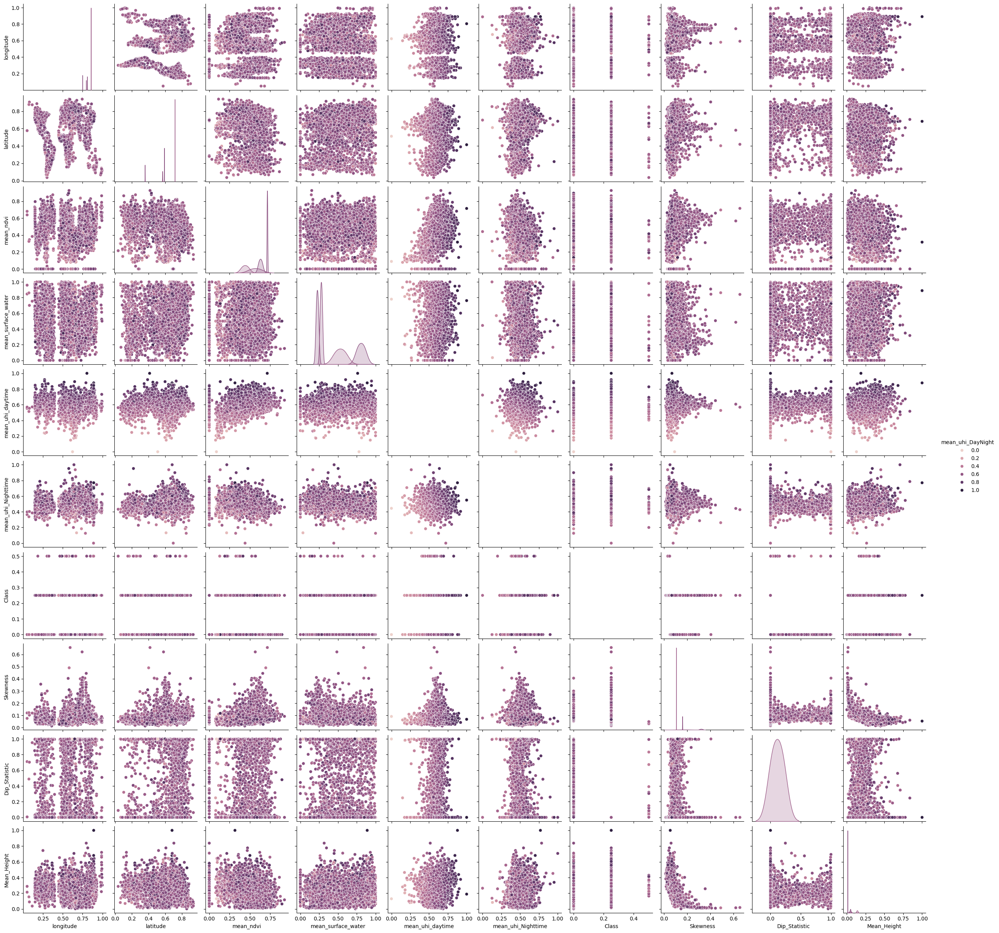

In [ ]:
sns.pairplot(UHI_scaled1,hue='mean_uhi_DayNight')

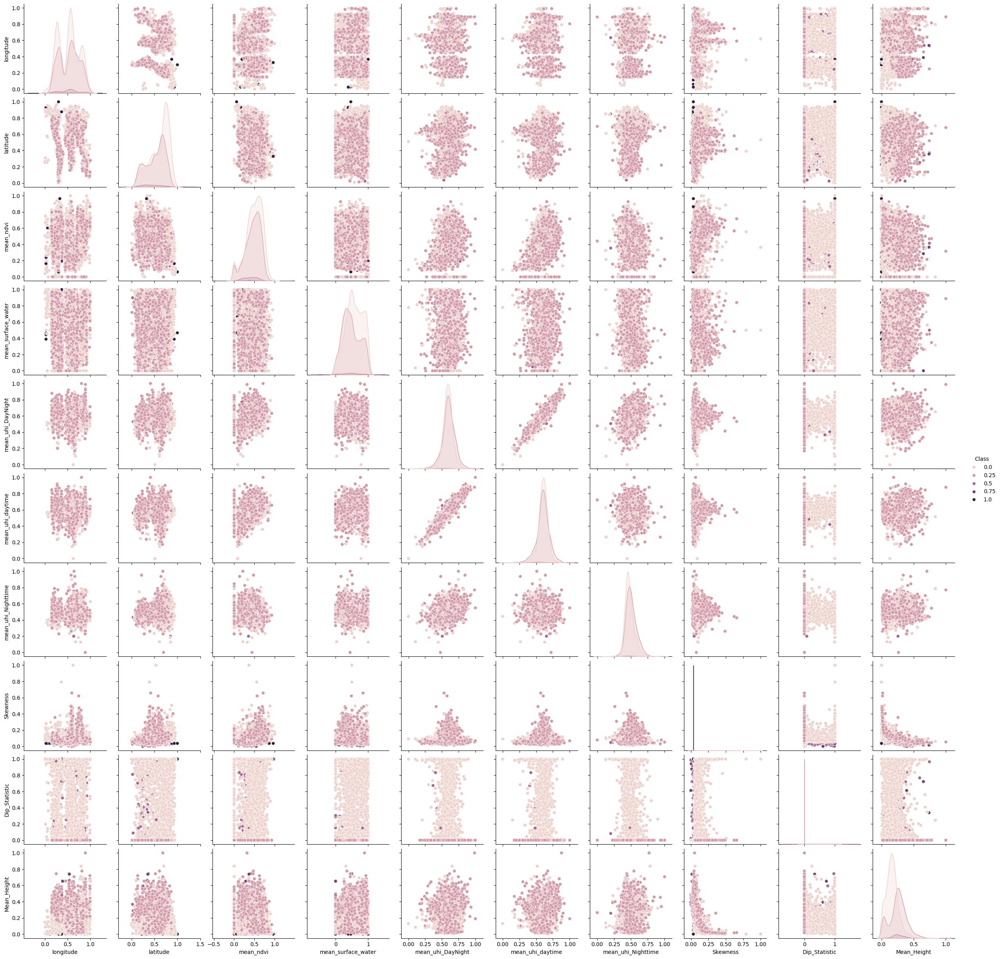

In [ ]:
sns.pairplot(UHI_scaled1,hue='Class')

In [ ]:
# fit Logistic regression model between UHI Day and Night mean value  and  ndvi mean, City shape, surface_water mean values, mean height, skewness, Dip statistic

UHI_scaled1.dropna(axis=1,how='all')
UHI_scaled1.loc[:,UHI_scaled1.notna().all(axis=0)]

logit_res1= sm.logit('mean_uhi_DayNight ~ mean_ndvi + Class +mean_surface_water +Mean_Height+ Skewness	+Dip_Statistic', data= UHI_scaled1 ).fit()

logit_res1.summary()
logit_res1.pred_table()



Optimization terminated successfully.
         Current function value: 0.655527
         Iterations 4


array([[5.000e+00, 3.970e+02],
       [2.000e+00, 3.344e+03]])

In [ ]:
logit_res1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:      mean_uhi_DayNight   No. Observations:                 3748
Model:                          Logit   Df Residuals:                     3741
Method:                           MLE   Df Model:                            6
Date:                Tue, 03 Dec 2024   Pseudo R-squ.:                  -1.009
Time:                        03:10:53   Log-Likelihood:                -2456.9
converged:                       True   LL-Null:                       -1222.9
Covariance Type:            nonrobust   LLR p-value:                     1.000
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -0.0566      0.200     -0.282      0.778      -0.449       0.336
mean_ndvi              0.5181      0.183      2.833      0.005       0.160       0.877
Class                 -0.0265      0.408     -0.065      0.948      -0.826       0.773
mean_surface_water    -0.1737      0.138     -1.258      0.208      -0.444       0.097
Mean_Height            0.8087      0.378      2.138      0.033       0.067       1.550
Skewness               1.1729      0.844      1.390      0.165      -0.481       2.827
Dip_Statistic         -0.0315      0.121     -0.261      0.794      -0.268       0.205
======================================================================================
"""